In [1]:
import glob
import itertools
import math
import os.path as osp
import time

import cv2
import matplotlib
import numpy as np

matplotlib.use("TkAgg")  # for macOS

import matplotlib.pyplot as plt

%matplotlib inline
plt.rcParams["figure.figsize"] = (20.0, 16.0)
plt.rcParams["image.interpolation"] = "bilinear"
plt.rcParams["image.cmap"] = "gray"

%load_ext autoreload
%autoreload 2
%load_ext autotime

time: 365 µs (started: 2023-03-11 13:25:21 +03:00)


# Panorama stitching

## Load Images

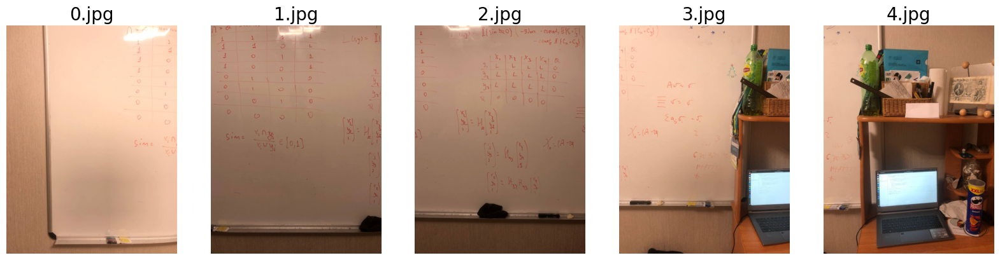

time: 918 ms (started: 2023-03-11 14:15:26 +03:00)


In [27]:
input_dir = "input"
ipaths = sorted(glob.glob(osp.join(input_dir, "*.jpg")))
n_imgs = len(ipaths)
dim = (1024, 1024)

mtx = np.loadtxt("mtx.txt")
dist = np.loadtxt("dist.txt")


images_info = dict()
for i_num, ipath in enumerate(ipaths):
    img = plt.imread(ipath)

    rows, cols = img.shape[:2]
    new_camera_mtx, roi = cv2.getOptimalNewCameraMatrix(
        cameraMatrix=mtx,
        distCoeffs=dist,
        imageSize=(cols, rows),
        alpha=1,
        newImgSize=(cols, rows),
    )

    img = cv2.undistort(
        src=img,
        cameraMatrix=mtx,
        distCoeffs=dist,
        dst=None,
        newCameraMatrix=new_camera_mtx,
    )

    roi_x, roi_y, roi_w, roi_h = roi
    img = img[roi_y : roi_y + roi_h, roi_x : roi_x + roi_w]
    # img = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
    # img = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
    images_info[ipath] = {"img": img}
    plt.subplot(1, n_imgs, i_num + 1)
    plt.title(osp.basename(ipath), fontsize=20)
    plt.axis("off")
    plt.imshow(images_info[ipath]["img"])
plt.show()

## Keypoints detection + descriptors

In [28]:
def keypoints_detection_sift(input_img):
    gray = cv2.cvtColor(input_img, cv2.COLOR_RGB2GRAY)
    sift = cv2.SIFT_create()
    kps, dscrs = sift.detectAndCompute(gray, None)
    return kps, dscrs

time: 871 µs (started: 2023-03-11 14:15:33 +03:00)


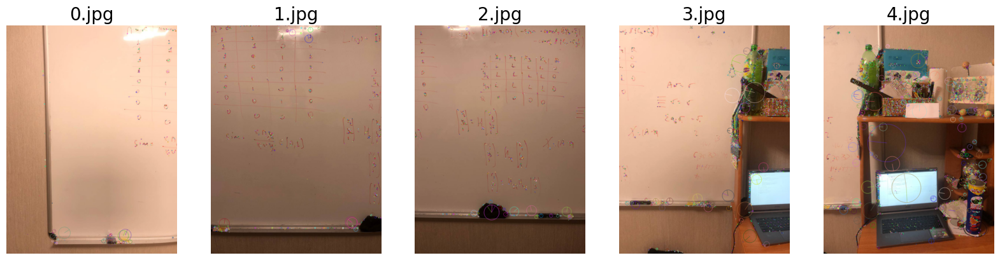

time: 1.84 s (started: 2023-03-11 14:15:34 +03:00)


In [29]:
for i_num, ipath in enumerate(images_info):
    img = images_info[ipath]["img"]
    keypoints, descriptors = keypoints_detection_sift(img)
    images_info[ipath]["keypoints"] = keypoints
    images_info[ipath]["descriptors"] = descriptors
    plt.subplot(1, n_imgs, i_num + 1)
    plt.title(osp.basename(ipaths[i_num]), fontsize=20)
    plt.imshow(
        cv2.drawKeypoints(
            img, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
        )
    )
    plt.axis("off")

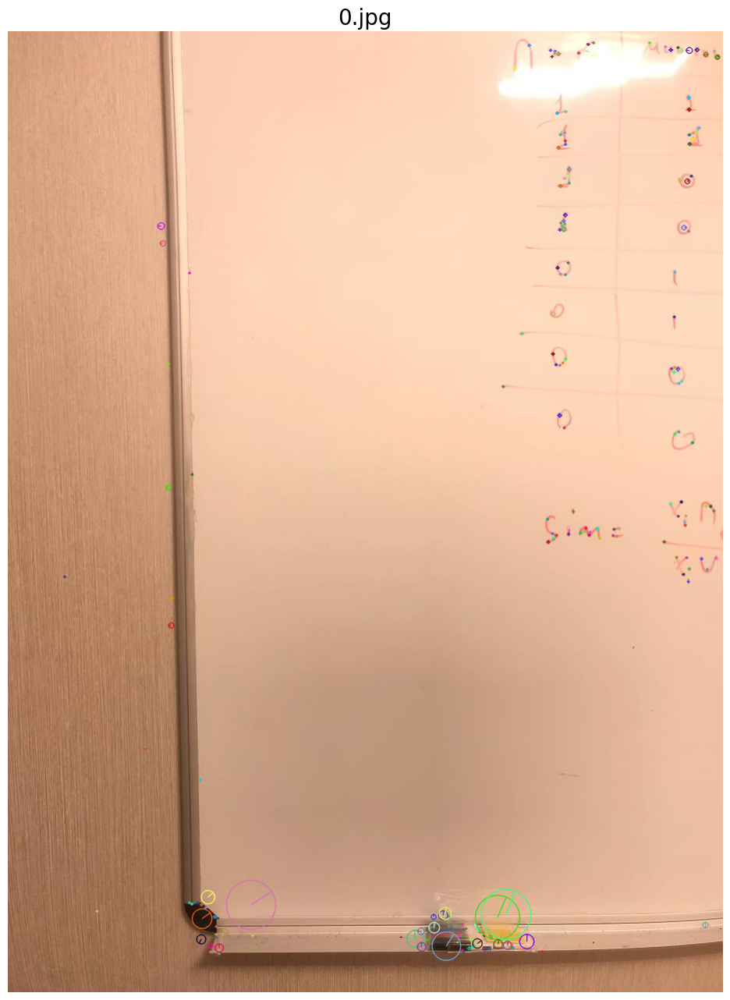

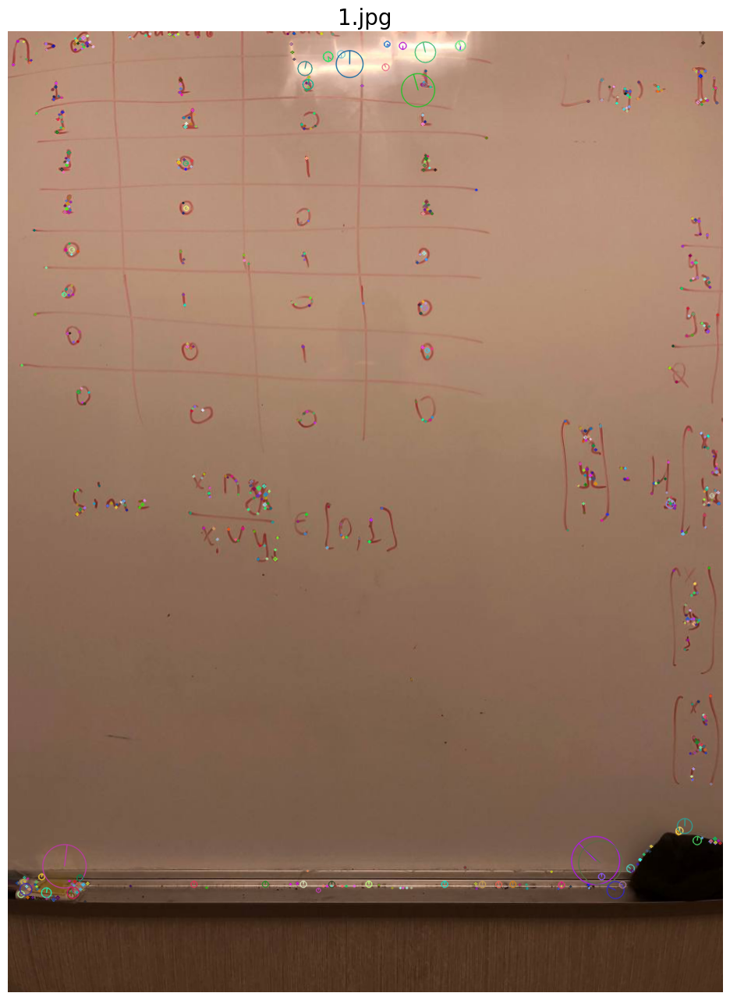

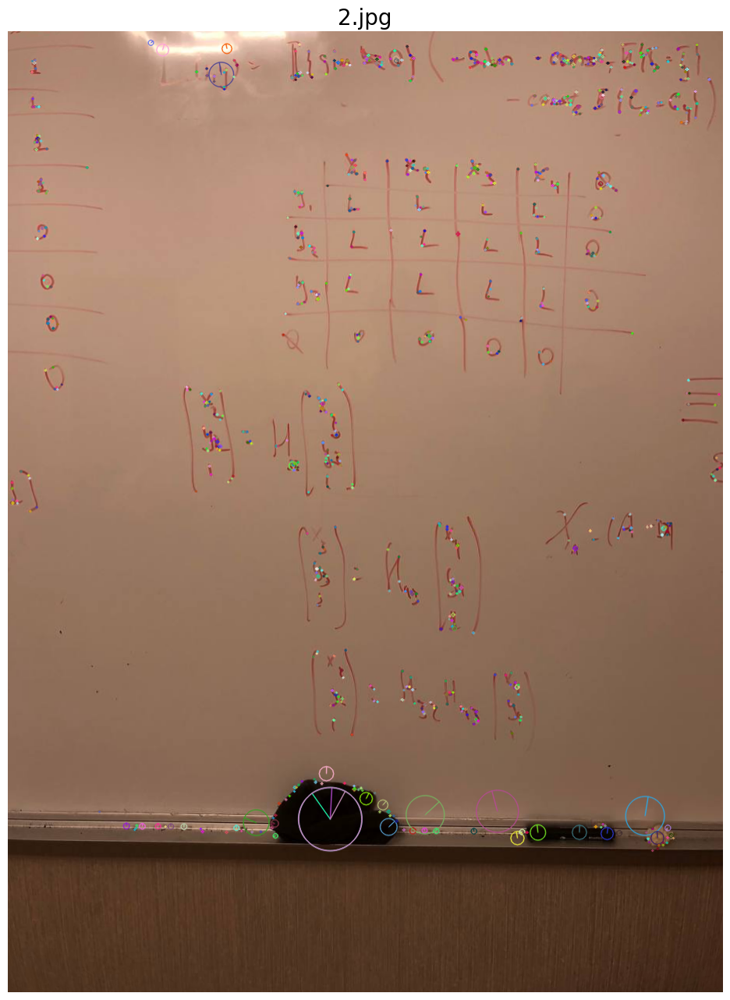

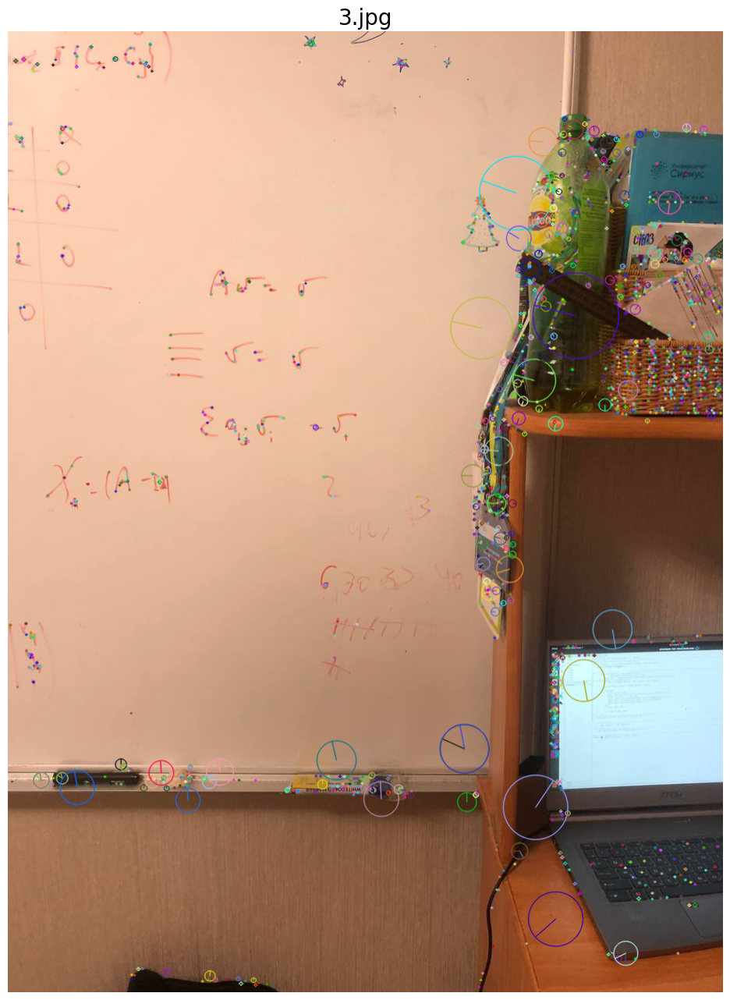

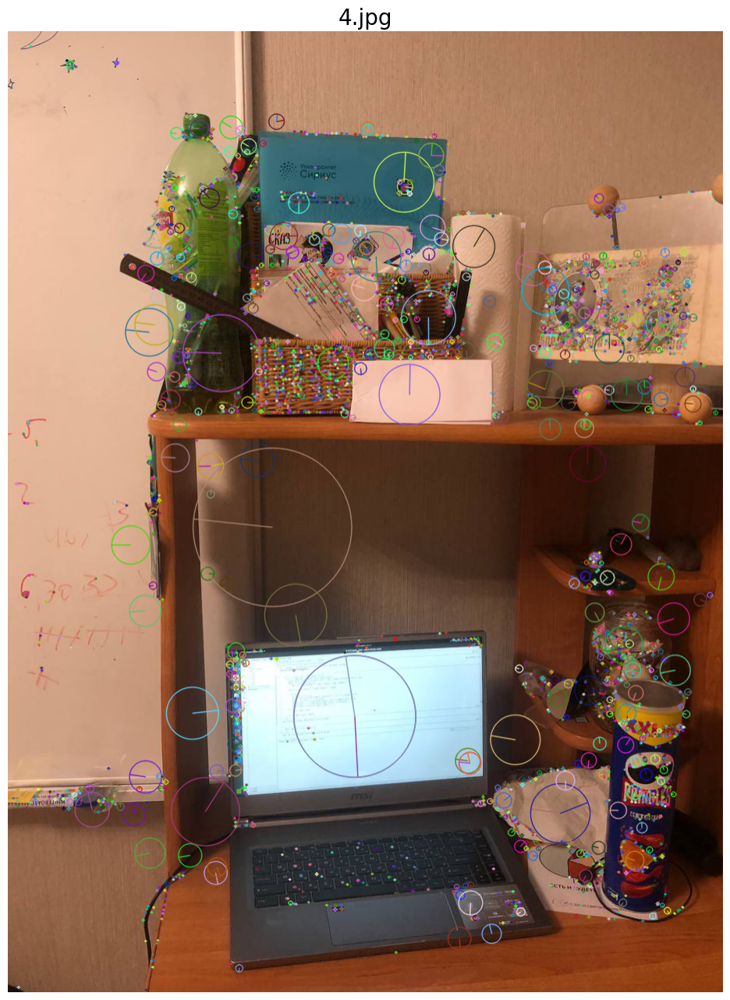

time: 3.29 s (started: 2023-03-11 14:15:41 +03:00)


In [30]:
for i_num, ipath in enumerate(images_info):
    img = images_info[ipath]["img"]
    keypoints, descriptors = keypoints_detection_sift(img)
    images_info[ipath]["keypoints"] = keypoints
    images_info[ipath]["descriptors"] = descriptors
    # plt.subplot(1, n_imgs, i_num + 1)
    plt.title(osp.basename(ipaths[i_num]), fontsize=20)
    plt.imshow(
        cv2.drawKeypoints(
            img, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
        )
    )
    plt.axis("off")
    plt.show()

In [31]:
keypoints, descriptors = (
    images_info[ipaths[0]]["keypoints"],
    images_info[ipaths[0]]["descriptors"],
)
keypoint = sorted(keypoints, key=lambda x: x.size, reverse=True)[0]
for field in dir(keypoint):
    if not field.startswith("_"):
        print(f"{field:10} {getattr(keypoint, field)}")

angle      290.95989990234375
class_id   -1
convert    <built-in method convert of type object at 0x7f34bbd338e0>
octave     7405828
overlap    <built-in method overlap of type object at 0x7f34bbd338e0>
pt         (638.38623046875, 1132.8062744140625)
response   0.022139906883239746
size       63.6707763671875
time: 873 µs (started: 2023-03-11 14:15:48 +03:00)


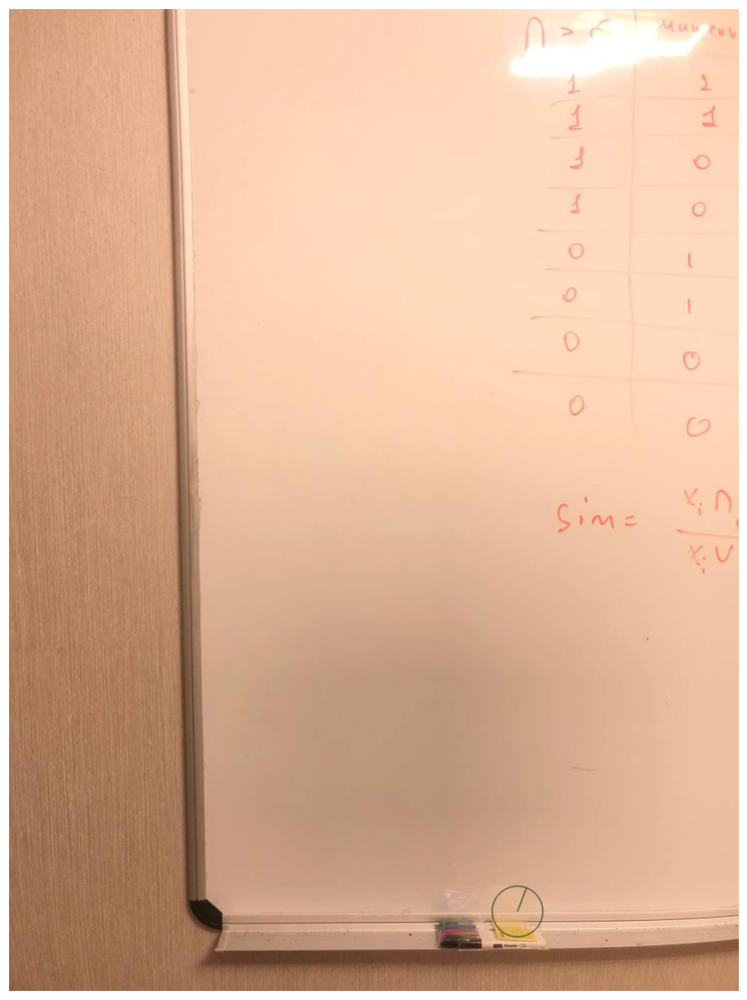

time: 345 ms (started: 2023-03-11 14:15:50 +03:00)


In [32]:
_ = plt.figure(figsize=(20, 14))
plt.imshow(
    cv2.drawKeypoints(
        images_info[ipaths[0]]["img"],
        [
            keypoint,
        ],
        None,
        flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS,
    )
)
plt.axis("off")
plt.show()

## Keypoints matching

### Bruteforce + Cross-check

In [49]:
def keypoints_matching_cross_check(dscrs1, dscrs2):
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    cross_matches = bf.match(dscrs1, dscrs2)
    return cross_matches

time: 854 µs (started: 2023-03-11 14:17:37 +03:00)


In [34]:
matches = keypoints_matching_cross_check(
    images_info[ipaths[0]]["descriptors"], images_info[ipaths[1]]["descriptors"]
)

time: 6.63 ms (started: 2023-03-11 14:15:55 +03:00)


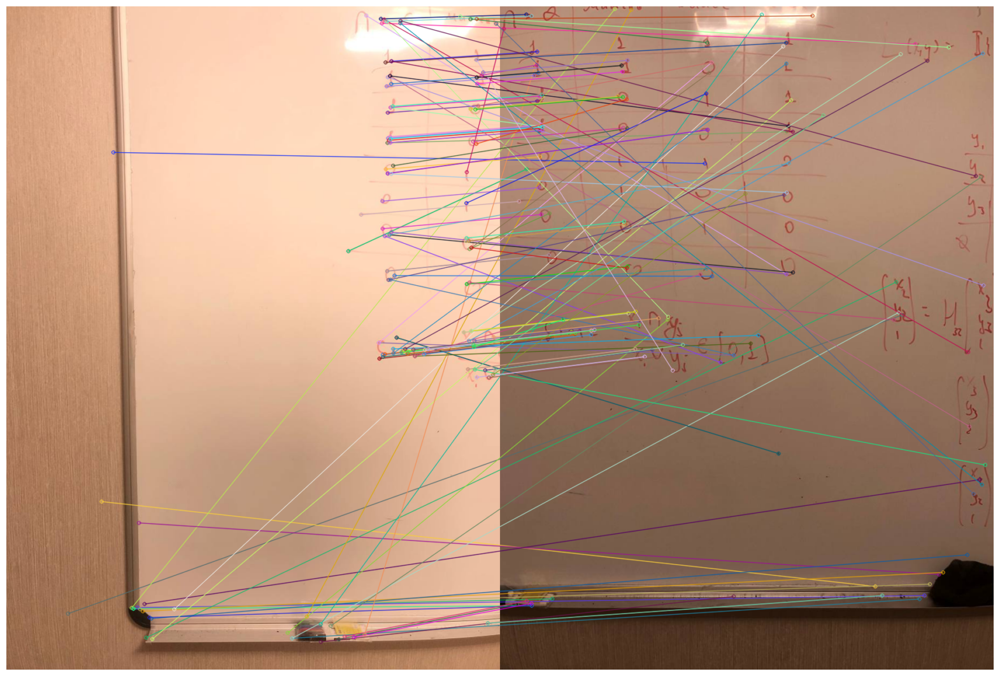

time: 628 ms (started: 2023-03-11 14:16:04 +03:00)


In [35]:
img_matches = cv2.drawMatches(
    images_info[ipaths[0]]["img"],
    images_info[ipaths[0]]["keypoints"],
    images_info[ipaths[1]]["img"],
    images_info[ipaths[1]]["keypoints"],
    matches,
    None,  # output image
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)
plt.imshow(img_matches)
plt.axis("off")
plt.show()

### KNN + Ratio test

In [50]:
def keypoints_matching_knn(dscrs1, dscrs2):
    bf = cv2.BFMatcher()
    tic = time.time_ns()
    knn_matches = bf.knnMatch(dscrs1, dscrs2, k=2)
    toc = time.time_ns()
    print(f"Matching time: {(toc - tic) / 10e6 :.5f} ms")
    good_matches = []
    for neighbour_1, neighbour_2 in knn_matches:
        if neighbour_1.distance < 0.90 * neighbour_2.distance:
            good_matches.append(neighbour_1)
    return good_matches

time: 1.18 ms (started: 2023-03-11 14:17:52 +03:00)


In [51]:
matches = keypoints_matching_knn(
    images_info[ipaths[0]]["descriptors"], images_info[ipaths[1]]["descriptors"]
)

Matching time: 0.10059 ms
time: 2.15 ms (started: 2023-03-11 14:17:54 +03:00)


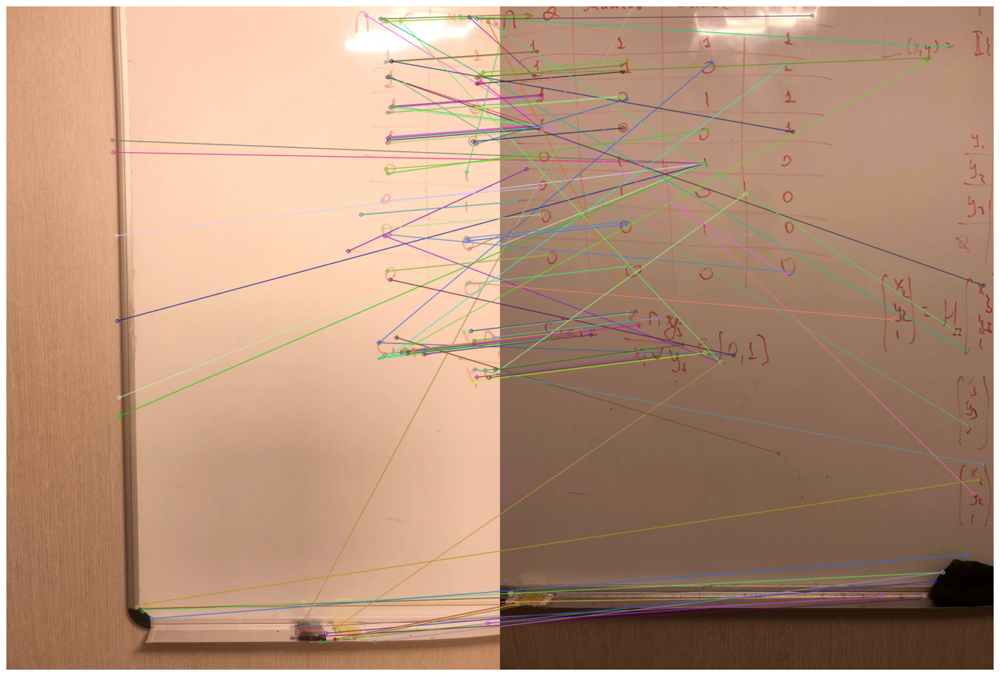

time: 645 ms (started: 2023-03-11 14:17:54 +03:00)


In [52]:
img_matches = cv2.drawMatches(
    images_info[ipaths[0]]["img"],
    images_info[ipaths[0]]["keypoints"],
    images_info[ipaths[1]]["img"],
    images_info[ipaths[1]]["keypoints"],
    matches,
    None,  # output image
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)
plt.imshow(img_matches)
plt.axis("off")
plt.show()

### FLANN

In [39]:
def keypoints_matching_flann(dscrs1, dscrs2):
    index_params = dict(algorithm=1, trees=5)  # FLANN_INDEX_KDTREE
    search_params = dict(checks=20)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    tic = time.time_ns()
    flann_matches = flann.knnMatch(dscrs1, dscrs2, k=2)
    toc = time.time_ns()
    print(f"Matching time: {(toc - tic) / 10e6 :.5f} ms")
    good_matches = []
    for neighbour_1, neighbour_2 in flann_matches:
        if neighbour_1.distance < 0.75 * neighbour_2.distance:
            good_matches.append(neighbour_1)
    return good_matches

time: 1.38 ms (started: 2023-03-11 14:16:16 +03:00)


In [40]:
matches = keypoints_matching_flann(
    images_info[ipaths[0]]["descriptors"], images_info[ipaths[1]]["descriptors"]
)

Matching time: 0.92204 ms
time: 12.3 ms (started: 2023-03-11 14:16:16 +03:00)


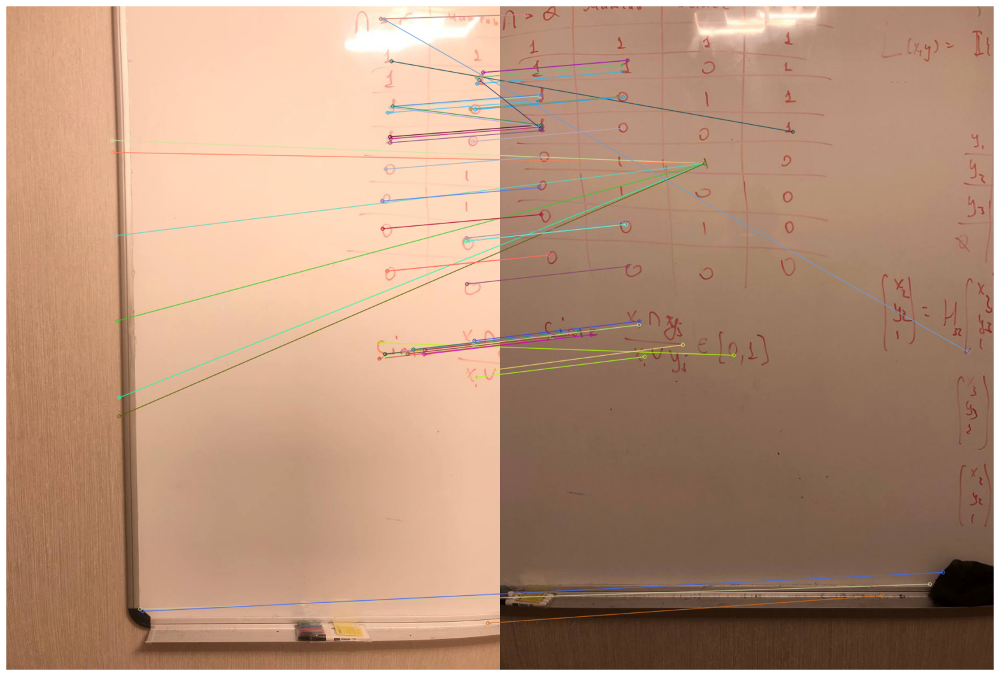

time: 615 ms (started: 2023-03-11 14:16:17 +03:00)


In [41]:
img_matches = cv2.drawMatches(
    images_info[ipaths[0]]["img"],
    images_info[ipaths[0]]["keypoints"],
    images_info[ipaths[1]]["img"],
    images_info[ipaths[1]]["keypoints"],
    matches,
    None,  # output image
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
)
plt.imshow(img_matches)
plt.axis("off")
plt.show()

### Find matches for images

In [53]:
matches_images = dict()
for ipath_0, ipath_1 in itertools.permutations(ipaths, 2):
    matches_pair = keypoints_matching_knn(
        images_info[ipath_0]["descriptors"], images_info[ipath_1]["descriptors"]
    )
    matches_images[(ipath_0, ipath_1)] = matches_pair

Matching time: 0.38915 ms
Matching time: 0.56050 ms
Matching time: 0.43774 ms
Matching time: 0.77929 ms
Matching time: 0.21262 ms
Matching time: 0.61702 ms
Matching time: 0.77571 ms
Matching time: 1.26077 ms
Matching time: 0.38775 ms
Matching time: 0.67521 ms
Matching time: 1.38641 ms
Matching time: 1.88077 ms
Matching time: 0.28121 ms
Matching time: 0.72518 ms
Matching time: 1.00665 ms
Matching time: 2.40481 ms
Matching time: 0.43614 ms
Matching time: 1.16365 ms
Matching time: 1.54618 ms
Matching time: 2.44973 ms
time: 205 ms (started: 2023-03-11 14:18:04 +03:00)


## Homography

In [54]:
homographies = dict()
for (ipath_0, ipath_1), matches in matches_images.items():
    src_pts = np.float32(
        [images_info[ipath_0]["keypoints"][m.queryIdx].pt for m in matches]
    ).reshape(-1, 1, 2)
    dst_pts = np.float32(
        [images_info[ipath_1]["keypoints"][m.trainIdx].pt for m in matches]
    ).reshape(-1, 1, 2)
    M, mask = cv2.findHomography(
        src_pts,
        dst_pts,
        cv2.RANSAC,
        ransacReprojThreshold=3.5,
        maxIters=20000,
        confidence=0.995,
    )
    homographies[ipath_0, ipath_1] = (M, mask.ravel().tolist())

time: 3.97 s (started: 2023-03-11 14:18:05 +03:00)


In [55]:
needed_pairs = []

start = 0
end = 1

while end < 5:
    needed_pairs.append((ipaths[start], ipaths[end]))

    start += 1
    end += 1

time: 724 µs (started: 2023-03-11 14:18:09 +03:00)


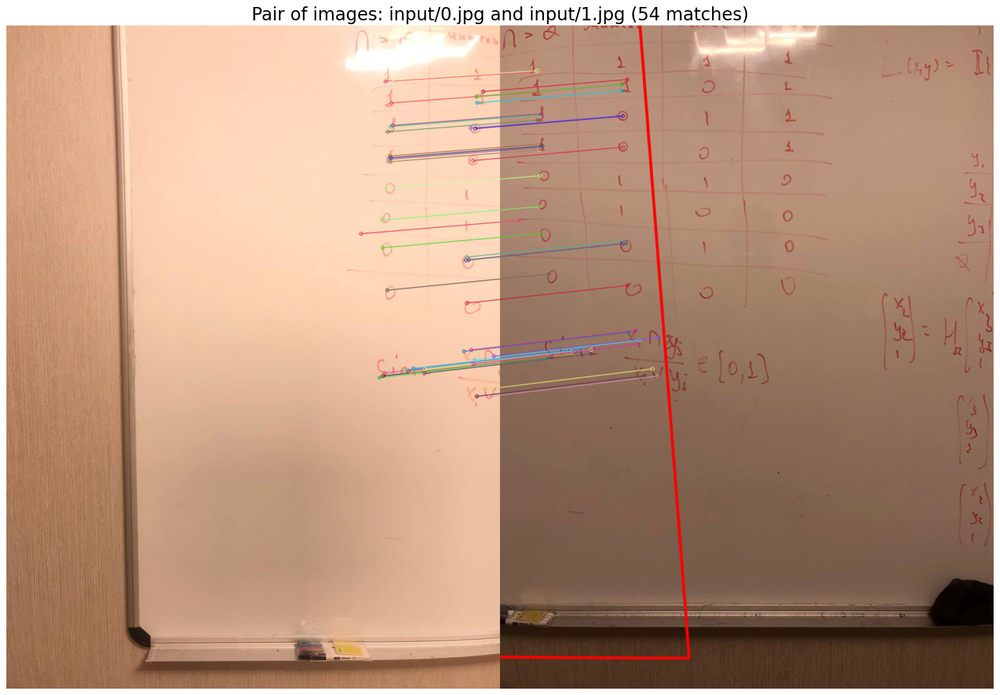

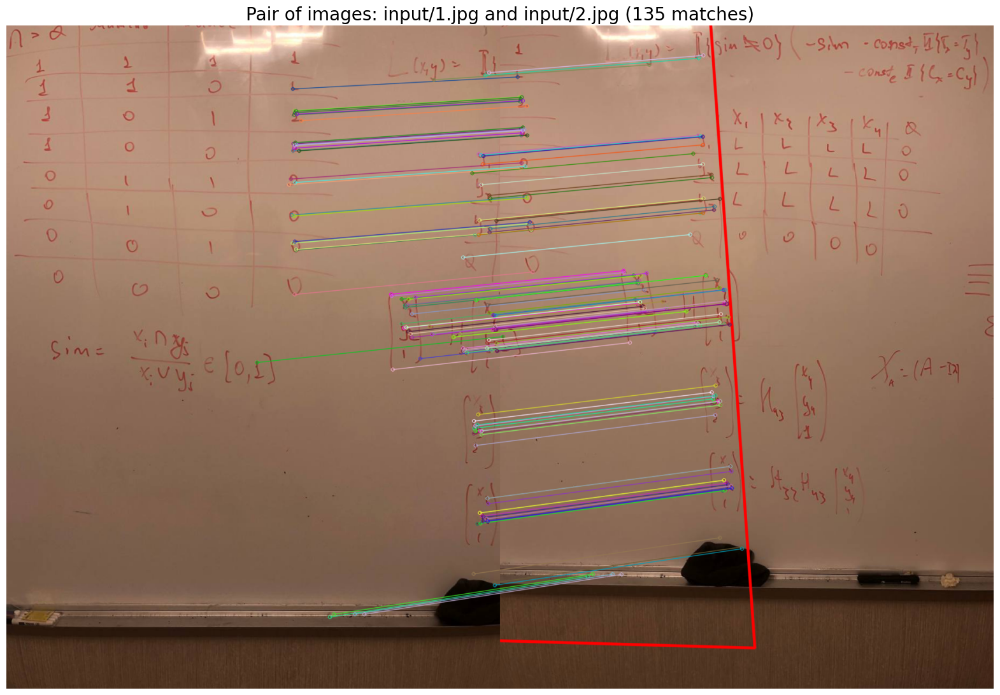

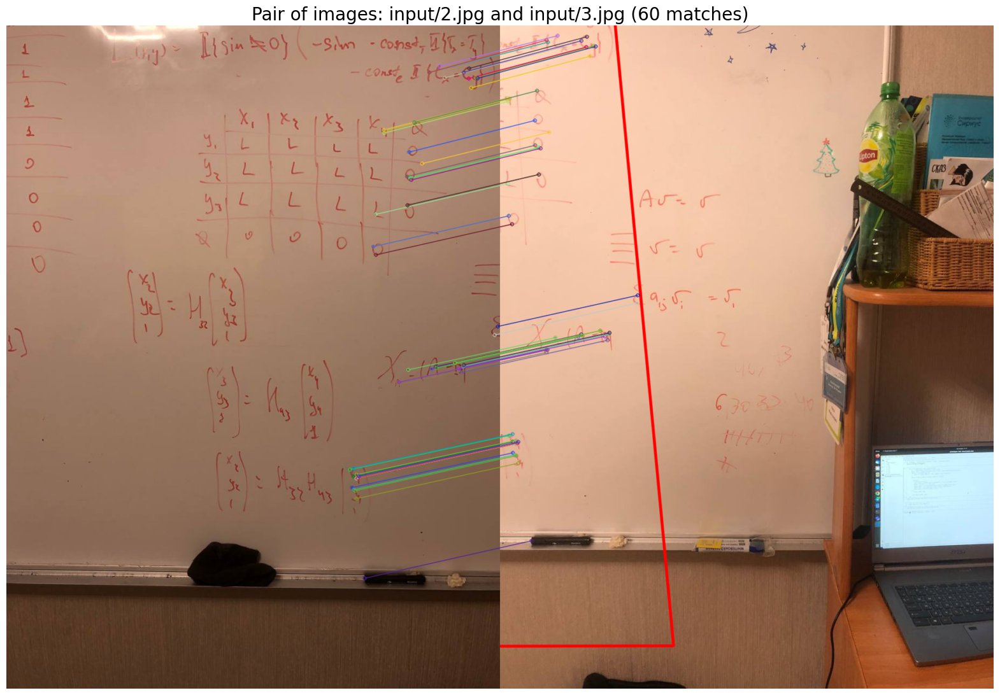

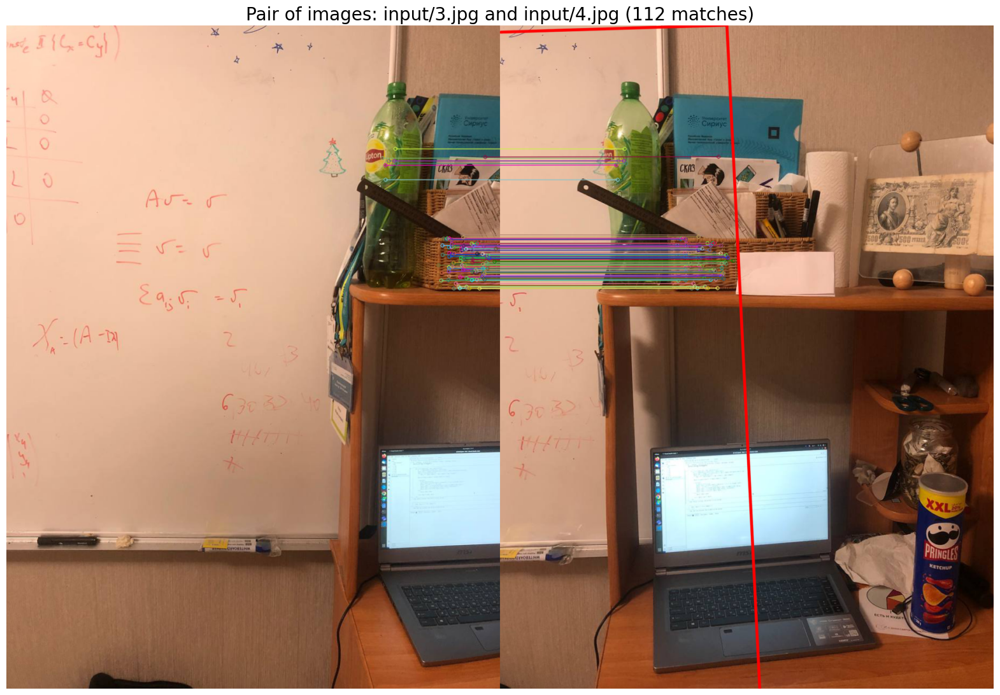

time: 2.93 s (started: 2023-03-11 14:18:09 +03:00)


In [56]:
for ipath_0, ipath_1 in needed_pairs:
    matches = matches_images[ipath_0, ipath_1]
    M, matches_mask = homographies[ipath_0, ipath_1]
    img_0, img_1_polylines = (
        images_info[ipath_0]["img"].copy(),
        images_info[ipath_1]["img"].copy(),
    )
    rows_0, cols_0 = img_0.shape[:2]
    rows_1, cols_1 = img_1_polylines.shape[:2]
    pts = np.float32([[0, 0], [0, rows_0], [cols_0, rows_0], [cols_0, 0]]).reshape(
        -1, 1, 2
    )
    dst = cv2.perspectiveTransform(pts, M)
    img_1_polylines = cv2.polylines(
        img_1_polylines, [np.int32(dst)], True, 255, 3, cv2.LINE_AA
    )
    img_matches = cv2.drawMatches(
        img_0,
        images_info[ipath_0]["keypoints"],
        img_1_polylines,
        images_info[ipath_1]["keypoints"],
        matches,
        None,  # output image
        matchesMask=matches_mask,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )
    plt.title(
        f"Pair of images: {ipath_0} and {ipath_1} ({sum(matches_mask)} matches)",
        fontsize=20,
    )
    plt.imshow(img_matches)
    plt.axis("off")
    plt.show()

## Stitching images

In [57]:
def stich_images(idx1, idx2, postproc=True):
    M, _ = homographies[ipaths[idx1], ipaths[idx2]]
    img_0, img_1 = images_info[ipaths[idx2]]["img"], images_info[ipaths[idx1]]["img"]
    img_0_1 = cv2.warpPerspective(
        img_1, M, (img_0.shape[1] + img_1.shape[1], img_1.shape[0])
    )
    img_0_1[0 : img_0.shape[0], 0 : img_0.shape[1]] = img_0

    if postproc:
        # Some postprocessing
        img_0_1_mask = np.where(img_0_1.sum(axis=2) != 0, 1, 0).astype("uint8")
        kernel = np.ones((5, 5), np.uint8)
        img_0_1_mask = cv2.morphologyEx(img_0_1_mask, cv2.MORPH_CLOSE, kernel)
        img_0_1_mask = cv2.erode(img_0_1_mask, kernel, iterations=1)
        img_0_1_mask = np.dstack(
            [
                img_0_1_mask,
            ]
            * 3
        )
    else:
        img_0_1_mask = None

    return img_0_1_mask, img_0_1


def stich_multiple_images(lowest_id, highest_id):
    idx2 = lowest_id
    idx1 = lowest_id + 1

    M, _ = homographies[ipaths[idx1], ipaths[idx2]]
    img_0, img_1 = images_info[ipaths[idx2]]["img"], images_info[ipaths[idx1]]["img"]
    img_0_1 = cv2.warpPerspective(
        img_1, M, (img_0.shape[1] * highest_id, img_1.shape[0] * 2)
    )
    img_0_1[0 : img_0.shape[0], 0 : img_0.shape[1]] = img_0

    # Some postprocessing
    img_0_1_mask = np.where(img_0_1.sum(axis=2) != 0, 1, 0).astype("uint8")
    kernel = np.ones((5, 5), np.uint8)
    img_0_1_mask = cv2.morphologyEx(img_0_1_mask, cv2.MORPH_CLOSE, kernel)
    img_0_1_mask = cv2.erode(img_0_1_mask, kernel, iterations=1)
    img_0_1_mask = np.dstack(
        [
            img_0_1_mask,
        ]
        * 3
    )

    idx1 += 1
    idx2 += 1

    while idx1 <= highest_id:
        M34, _ = homographies[ipaths[idx1], ipaths[idx2]]
        img_4 = images_info[ipaths[idx1]]["img"]
        img_3 = images_info[ipaths[idx2]]["img"]
        # img_0, img_1 = images_info[ipaths[3]]['img'], images_info[ipaths[4]]['img']
        M = M @ M34
        img_4_3_2 = cv2.warpPerspective(
            img_4, M, (img_0_1.shape[1], img_4.shape[0] * 2)
        )
        panorama = np.where(img_0_1_mask != 0, img_0_1, img_4_3_2)
        img_0_1 = panorama

        img_0_1[0 : img_0.shape[0], 0 : img_0.shape[1]] = img_0

        # Some postprocessing
        img_0_1_mask = np.where(img_0_1.sum(axis=2) != 0, 1, 0).astype("uint8")
        kernel = np.ones((5, 5), np.uint8)
        img_0_1_mask = cv2.morphologyEx(img_0_1_mask, cv2.MORPH_CLOSE, kernel)
        img_0_1_mask = cv2.erode(img_0_1_mask, kernel, iterations=1)
        img_0_1_mask = np.dstack(
            [
                img_0_1_mask,
            ]
            * 3
        )

        idx1 += 1
        idx2 += 1

    return img_0_1

time: 2.35 ms (started: 2023-03-11 14:18:28 +03:00)


In [58]:
img_0_1 = stich_multiple_images(0, 4)

time: 1.07 s (started: 2023-03-11 14:18:28 +03:00)


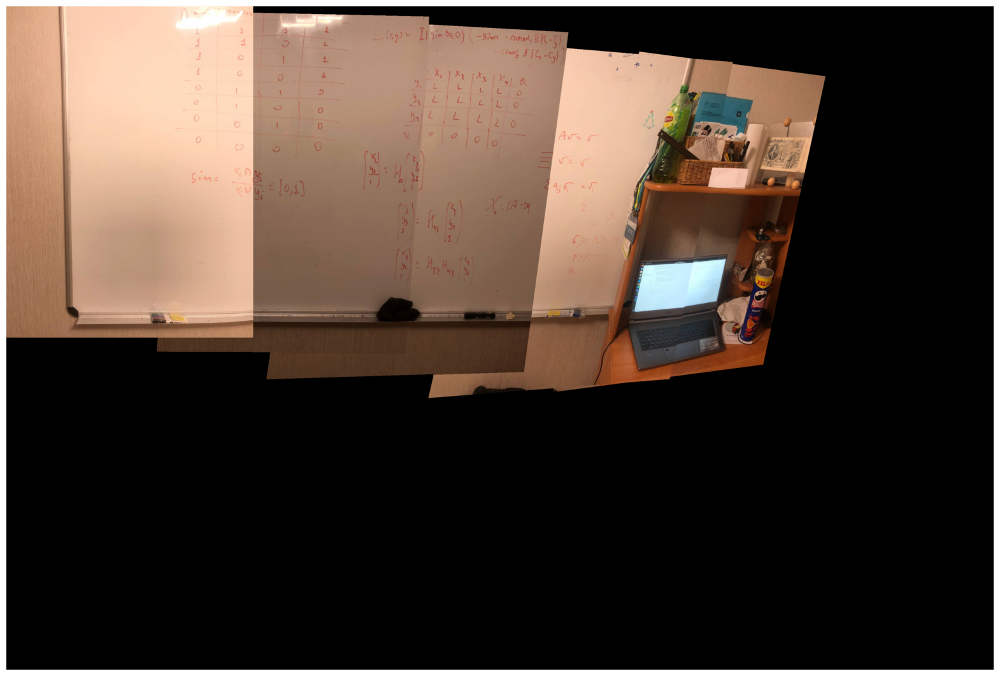

time: 1.31 s (started: 2023-03-11 14:18:30 +03:00)


In [59]:
plt.imshow(img_0_1)
plt.axis("off")
plt.show()

Видно, что последнее изображение немного плющит, это связано с тем, что видимо сьемка была на разных уровнях и разной отдаленности, а клеить все вместе как то надо. По символам на маркерной доске можно заметить, что вся склейка прошла как надо, ничего не меняется в плохом смысле, даже ноутбук в конце ровно склеился. Конечно все портят четкие границы, но это проблемы освещения(
    
Я специально увеличил масштаб, чтобы было видно, как они там склеились. Ну и со светом некоторые разности, как видимо освещение разное на разных изображениях. Я попробовал это пофиксить ниже, вышло не то чтобы круто, но лучше чем было кажется)

In [60]:
image = img_0_1

hh, ww = image.shape[:2]
print(hh, ww)
max = max(hh, ww)

# illumination normalize
ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)

# separate channels
y, cr, cb = cv2.split(ycrcb)

# get background which paper says (gaussian blur using standard deviation 5 pixel for 300x300 size image)
# account for size of input vs 300
sigma = int(5 * max / 300)
print("sigma: ", sigma)
gaussian = cv2.GaussianBlur(y, (0, 0), sigma, sigma)

# subtract background from Y channel
y = y - gaussian + 100

# merge channels back
ycrcb = cv2.merge([y, cr, cb])

# convert to BGR
output = cv2.cvtColor(ycrcb, cv2.COLOR_YCrCb2BGR)

2466 3668
sigma:  61
time: 1.04 s (started: 2023-03-11 14:18:43 +03:00)


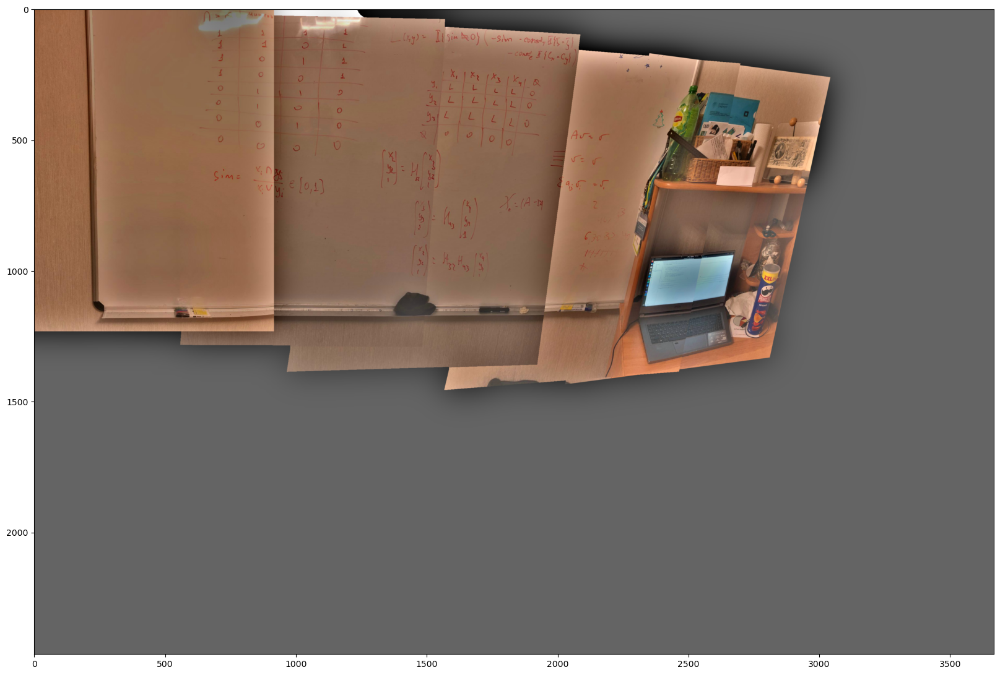

time: 1.53 s (started: 2023-03-11 14:18:45 +03:00)


In [61]:
plt.imshow(output)

# My Implmentation of MatchingPoints and resulting Panorama

Здесь я переписал брутфорс метчинг точек по L2 метрике, панорама получилась почти такая же, чуть хуже, потому что не использовалась техника с удалением False Positive точек через сравнение с ближайшим соседом по порогу. 

In [62]:
from dataclasses import dataclass


@dataclass
class Match:
    queryIdx: int
    trainIdx: int


def dist(X, Y):
    sx = np.sum(X**2, axis=1, keepdims=True)
    sy = np.sum(Y**2, axis=1, keepdims=True)
    return np.sqrt(-2 * X.dot(Y.T) + sx + sy.T)


def BFKeyPoints(src, dst, cross_check=True):
    d = dist(src, dst)

    res = []

    for i in range(src.shape[0]):
        matched_idx = d[i].argmin()

        if cross_check:
            matched_inverse = d[:, matched_idx].argmin()
            if matched_inverse != i:
                continue

        res.append(Match(i, matched_idx))

    return res

time: 1.85 ms (started: 2023-03-11 14:19:02 +03:00)


In [69]:
matches_images = dict()
for ipath_0, ipath_1 in itertools.permutations(ipaths, 2):
    matches_pair = BFKeyPoints(
        images_info[ipath_0]["descriptors"], images_info[ipath_1]["descriptors"]
    )
    matches_images[(ipath_0, ipath_1)] = matches_pair

homographies = dict()
for (ipath_0, ipath_1), matches in matches_images.items():
    src_pts = np.float32(
        [images_info[ipath_0]["keypoints"][m.queryIdx].pt for m in matches]
    ).reshape(-1, 1, 2)
    dst_pts = np.float32(
        [images_info[ipath_1]["keypoints"][m.trainIdx].pt for m in matches]
    ).reshape(-1, 1, 2)
    M, mask = cv2.findHomography(
        src_pts,
        dst_pts,
        cv2.RANSAC,
        ransacReprojThreshold=4,
        maxIters=20000,
        confidence=0.995,
    )
    homographies[ipath_0, ipath_1] = (M, mask.ravel().tolist())

time: 5.61 s (started: 2023-03-11 14:19:53 +03:00)


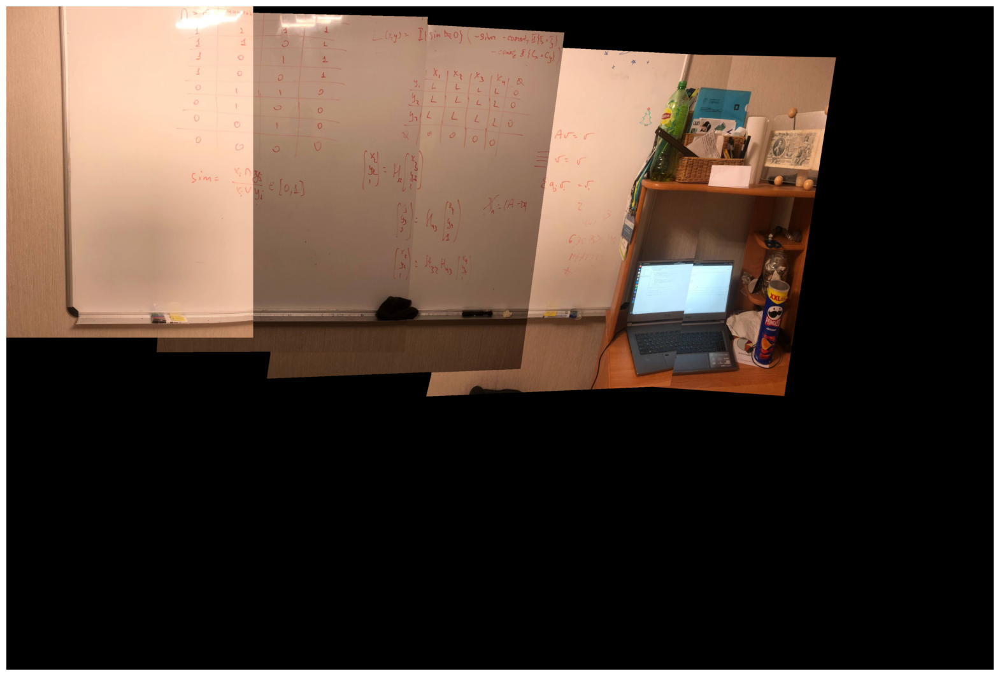

time: 2.59 s (started: 2023-03-11 14:19:59 +03:00)


In [70]:
img_0_1 = stich_multiple_images(0, 4)

plt.imshow(img_0_1)
plt.axis("off")
plt.show()

# DISK

In [16]:
import h5py
import numpy as np

In [ ]:
%%bash
git clone --recurse-submodules https://github.com/cvlab-epfl/disk.git
pip install -r disk/requirements.txt
python disk/detect.py h5_artifacts_destination input/
python disk/match.py h5_artifacts_destination --rt 0.95

In [192]:
keypoints = h5py.File("h5_artifacts_destination/keypoints.h5", "r")
matches = h5py.File("h5_artifacts_destination/matches.h5", "r")

time: 1.34 ms (started: 2023-03-09 15:02:54 +03:00)


In [193]:
needed_pairs = []

start = 0
end = 1
while end < 5:
    needed_pairs.append((str(start), str(end)))
    start += 1
    end += 1

time: 982 µs (started: 2023-03-09 15:02:56 +03:00)


In [214]:
homographies = dict()
for src, dst in needed_pairs:
    src_path = "input/" + src + ".jpg"
    # dst_path =

    match = matches[src][dst]
    keypoint_src = keypoints[src]
    keypoint_dst = keypoints[dst]

    src_points = []
    dst_points = []
    for i in range(match.shape[1]):
        src_idx = match[0, i]
        dst_idx = match[1, i]

        src_points.append(keypoint_src[src_idx])
        dst_points.append(keypoint_dst[dst_idx])

    src_pts = np.float32(src_points).reshape(-1, 1, 2)

    dst_pts = np.float32(dst_points).reshape(-1, 1, 2)

    M, mask = cv2.findHomography(
        src_pts,
        dst_pts,
        cv2.RANSAC,
        ransacReprojThreshold=0.5,
        maxIters=20000,
        confidence=0.995,
    )
    homographies[src, dst] = (M, mask.ravel().tolist())

time: 2.1 s (started: 2023-03-09 15:05:05 +03:00)


In [215]:
def stich_multiple_images(lowest_id, highest_id):
    idx2 = lowest_id
    idx1 = lowest_id + 1

    M, _ = homographies[(str(idx2), str(idx1))]
    M = np.linalg.inv(M)
    img_0, img_1 = images_info[ipaths[idx2]]["img"], images_info[ipaths[idx1]]["img"]
    img_0_1 = cv2.warpPerspective(
        img_1, M, (img_0.shape[1] * highest_id, img_1.shape[0] * 2)
    )
    img_0_1[0 : img_0.shape[0], 0 : img_0.shape[1]] = img_0

    # Some postprocessing
    img_0_1_mask = np.where(img_0_1.sum(axis=2) != 0, 1, 0).astype("uint8")
    kernel = np.ones((5, 5), np.uint8)
    img_0_1_mask = cv2.morphologyEx(img_0_1_mask, cv2.MORPH_CLOSE, kernel)
    img_0_1_mask = cv2.erode(img_0_1_mask, kernel, iterations=1)
    img_0_1_mask = np.dstack(
        [
            img_0_1_mask,
        ]
        * 3
    )

    idx1 += 1
    idx2 += 1

    while idx1 <= highest_id:
        M34, _ = homographies[(str(idx2), str(idx1))]
        M34 = np.linalg.inv(M34)
        img_4 = images_info[ipaths[idx1]]["img"]
        img_3 = images_info[ipaths[idx2]]["img"]
        # img_0, img_1 = images_info[ipaths[3]]['img'], images_info[ipaths[4]]['img']
        M = M @ M34
        img_4_3_2 = cv2.warpPerspective(
            img_4, M, (img_0_1.shape[1], img_4.shape[0] * 2)
        )
        panorama = np.where(img_0_1_mask != 0, img_0_1, img_4_3_2)
        img_0_1 = panorama

        img_0_1[0 : img_0.shape[0], 0 : img_0.shape[1]] = img_0

        # Some postprocessing
        img_0_1_mask = np.where(img_0_1.sum(axis=2) != 0, 1, 0).astype("uint8")
        kernel = np.ones((5, 5), np.uint8)
        img_0_1_mask = cv2.morphologyEx(img_0_1_mask, cv2.MORPH_CLOSE, kernel)
        img_0_1_mask = cv2.erode(img_0_1_mask, kernel, iterations=1)
        img_0_1_mask = np.dstack(
            [
                img_0_1_mask,
            ]
            * 3
        )

        idx1 += 1
        idx2 += 1

    return img_0_1

time: 2.02 ms (started: 2023-03-09 15:05:07 +03:00)


In [216]:
res = stich_multiple_images(0, 4)

time: 1.22 s (started: 2023-03-09 15:05:07 +03:00)


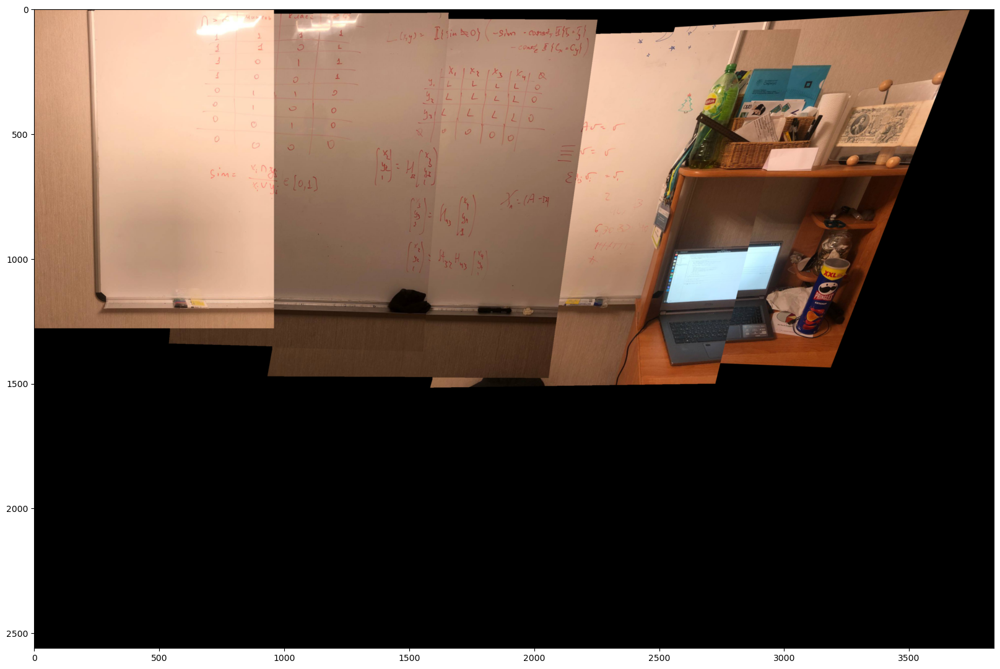

time: 1.51 s (started: 2023-03-09 15:05:08 +03:00)


In [217]:
plt.imshow(res)

Как я не менял параметры, с диском почему то последнее изображение прям плохо приклеивается, ноутбук постоянно перекашивает. Видимо, он отсекает точки, которые могли бы помочь его выровнять нормально. Но даже меняя параметры разные, я не добился того чтобы он нормально их сопоставлял.

# Camera calibration

Для калибровки камер мы будем использовать специальный паттерн, который называется шахматная доска. Его параметры нам хорошо известны, поэтому с его помощью откалибровать камеру будет проще, чем через пайплайн, который мы использовали для построения панорамы.
Изображение chessboard можно найти в поставке opencv на [github](https://github.com/opencv/opencv/blob/4.x/samples/data/chessboard.png)
Его необходимо распечатать и сфотографировать с разных углов и расстояний, чтобы получить достаточное количество изображений для калибровки камеры. Суммарное количество изображений должно быть не менее 10.

In [16]:
input_dir = "./calibration_photos/"
chessboard_ipaths = sorted(glob.glob(osp.join(input_dir, "chessboard_*.jpg")))
n_chessboard_imgs = len(chessboard_ipaths)
print(f"Number of chessboard images: {n_chessboard_imgs}")

Number of chessboard images: 15
time: 870 µs (started: 2023-03-11 13:27:29 +03:00)


На каждом изображении необходимо найти углы шахматной доски. Для этого используется функция `cv2.findChessboardCorners`. С помощью этой функции мы получим соответствие между углами шахматной доски в реальном мире (object points) и точками на изображении (image points)
После нахождения углов их местоположение можно доуточнить с помощью функции `cv2.cornerSubPix`. Вы можете воспользоваться этой функцией, если вам будет недостаточно получаемого без неё качества калибровки.

In [17]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(8,5,0)
objp = np.zeros((6 * 9, 3), np.float32)
objp[:, :2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)
# Arrays to store object points and image points from all the images
obj_points = []  # 3d points in real world space
img_points = []  # 2d points in image plane.

time: 792 µs (started: 2023-03-11 13:27:31 +03:00)


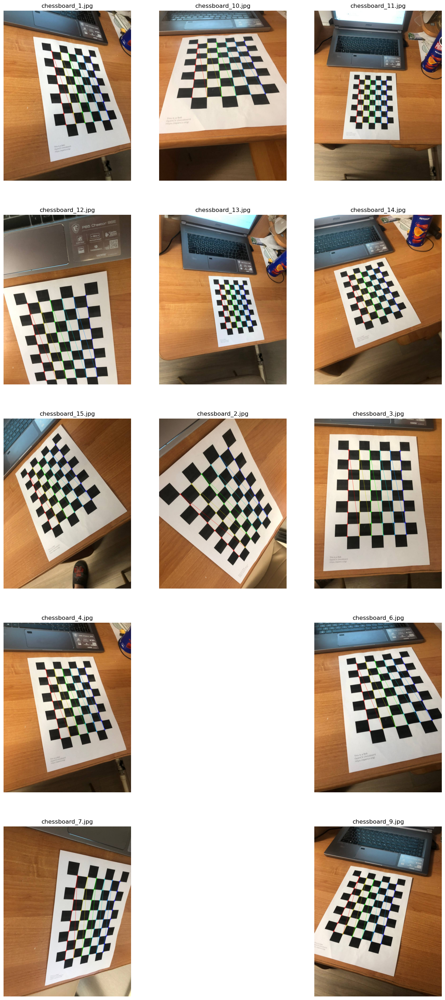

time: 3.54 s (started: 2023-03-11 13:27:35 +03:00)


In [18]:
_ = plt.figure(figsize=(16, 36))
for i_num, ipath in enumerate(chessboard_ipaths):
    img = cv2.cvtColor(cv2.imread(ipath), cv2.COLOR_BGR2RGB)
    img_grayscale = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    result, corners = cv2.findChessboardCorners(img_grayscale, (9, 6), None)
    if result:
        obj_points.append(objp)
        img_points.append(corners)

        cv2.drawChessboardCorners(img, (9, 6), corners, result)
        plt.subplot(math.ceil(n_chessboard_imgs / 3), 3, i_num + 1)
        plt.title(osp.basename(ipath), fontsize=12)
        plt.axis("off")
        plt.imshow(img)
plt.show()

Имея соответствие между углами шахматной доски в реальном мире и точками на изображении, можно калибровать камеру. Для этого используется функция `cv2.calibrateCamera`. В результате калибровки мы получим матрицу камеры и коэффициенты дисторсии.

In [19]:
img = cv2.cvtColor(cv2.imread(chessboard_ipaths[-1]), cv2.COLOR_BGR2RGB)
img_grayscale = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
result, mtx, dist, r_vecs, t_vecs = cv2.calibrateCamera(
    objectPoints=obj_points,
    imagePoints=img_points,
    imageSize=img_grayscale.shape[::-1],
    cameraMatrix=None,
    distCoeffs=None,
)
print(f"Camera matrix:\n{mtx}")
print(f"Distortion coefficients:\n{dist}")

Camera matrix:
[[1.04437944e+03 0.00000000e+00 4.83514573e+02]
 [0.00000000e+00 1.04358628e+03 6.20717831e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Distortion coefficients:
[[ 0.25239181 -1.06468593 -0.0046666   0.00415609  1.5384397 ]]
time: 85 ms (started: 2023-03-11 13:28:07 +03:00)


In [20]:
np.savetxt("mtx.txt", mtx)
np.savetxt("dist.txt", dist)

time: 1.88 ms (started: 2023-03-11 13:28:10 +03:00)


Эти параметры можно использовать для коррекции изображений, полученных с данной камеры. Для этого используется функция `cv2.undistort`. При этом можно использовать функцию `cv2.getOptimalNewCameraMatrix`, чтобы получить новую матрицу камеры. Она будет содержать только те пиксели, которые содержат информацию об изображении.

In [21]:
rows, cols = img.shape[:2]
new_camera_mtx, roi = cv2.getOptimalNewCameraMatrix(
    cameraMatrix=mtx,
    distCoeffs=dist,
    imageSize=(cols, rows),
    alpha=1,
    newImgSize=(cols, rows),
)
print(f"New camera matrix:\n{new_camera_mtx}")
print(f"Region of interest:\n{roi}")

New camera matrix:
[[1.06244043e+03 0.00000000e+00 4.85942642e+02]
 [0.00000000e+00 1.06820801e+03 6.16360119e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
Region of interest:
(21, 19, 917, 1233)
time: 3.07 ms (started: 2023-03-11 14:10:10 +03:00)


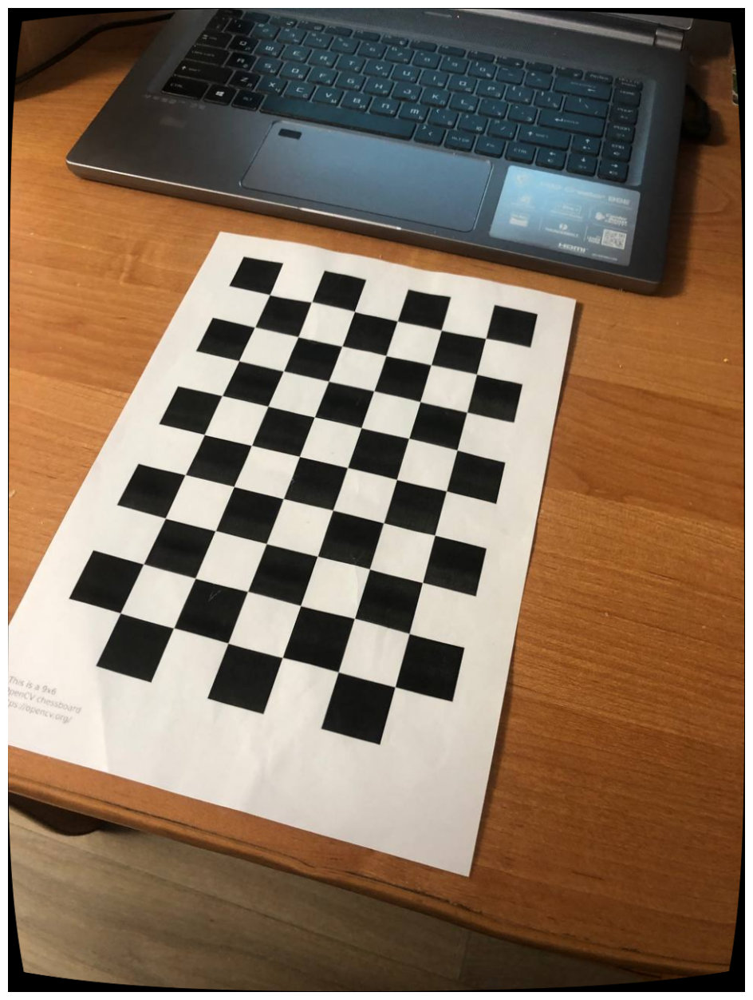

time: 561 ms (started: 2023-03-11 14:10:15 +03:00)


In [22]:
dst = cv2.undistort(
    src=img, cameraMatrix=mtx, distCoeffs=dist, dst=None, newCameraMatrix=new_camera_mtx
)

plt.imshow(dst)
plt.axis("off")
plt.show()

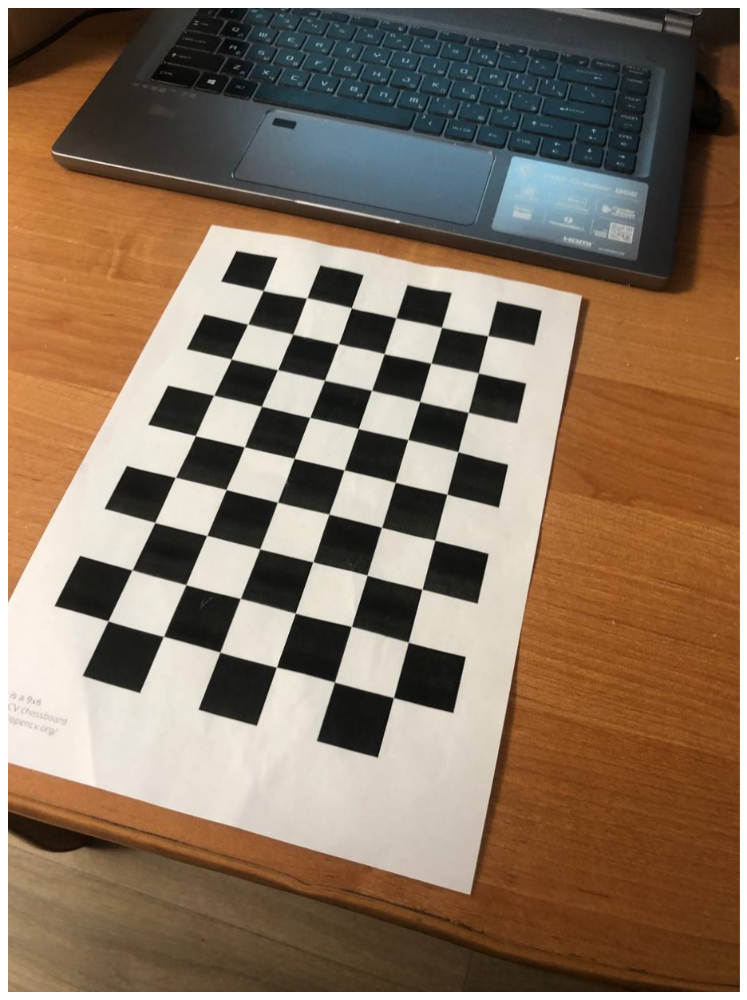

time: 502 ms (started: 2023-03-11 14:10:22 +03:00)


In [23]:
roi_x, roi_y, roi_w, roi_h = roi
dst = dst[roi_y : roi_y + roi_h, roi_x : roi_x + roi_w]
plt.imshow(dst)
plt.axis("off")
plt.show()

# Fundamental matrix

In [71]:
matches = matches_images[ipaths[0], ipaths[1]]
M, matches_mask = homographies[ipaths[0], ipaths[1]]

pts_0, pts_1 = list(), list()
for match_mask, match in zip(matches_mask, matches):
    # if match_mask:
    pts_1.append(images_info[ipaths[1]]["keypoints"][match.trainIdx].pt)
    pts_0.append(images_info[ipaths[0]]["keypoints"][match.queryIdx].pt)
pts_0 = np.int32(pts_0)
pts_1 = np.int32(pts_1)

time: 1.16 ms (started: 2023-03-11 14:21:10 +03:00)


In [72]:
F, mask = cv2.findFundamentalMat(pts_0, pts_1, cv2.FM_LMEDS, ransacReprojThreshold=0.5)
pts_0 = pts_0[mask.ravel() == 1]
pts_1 = pts_1[mask.ravel() == 1]

time: 5.7 ms (started: 2023-03-11 14:21:11 +03:00)


In [73]:
print(f"Number of inliers: {len(pts_0)}")

Number of inliers: 84
time: 553 µs (started: 2023-03-11 14:21:13 +03:00)


In [74]:
def draw_lines(img_0_orig, lines, pts_0_orig, pts_1_orig):
    img_0_vis = img_0_orig.copy()
    r, c, _ = img_0_vis.shape
    for r, pt_0, pt_1 in zip(lines, pts_0_orig, pts_1_orig):
        color = np.random.randint(0, 255, 3).tolist()
        x_0, y_0 = map(int, [0, -r[2] / r[1]])
        x_1, y_1 = map(int, [c, -(r[2] + r[0] * c) / r[1]])
        img_0_vis = cv2.line(img_0_vis, (x_0, y_0), (x_1, y_1), color, 1)
        img_0_vis = cv2.circle(img_0_vis, tuple(pt_0), 5, color, -1)
    return img_0_vis

time: 873 µs (started: 2023-03-11 14:21:15 +03:00)


In [75]:
lines_0 = cv2.computeCorrespondEpilines(pts_1.reshape(-1, 1, 2), 2, F)
lines_0 = lines_0.reshape(-1, 3)
img_vis_0 = draw_lines(images_info[ipaths[0]]["img"], lines_0, pts_0, pts_1)

lines_1 = cv2.computeCorrespondEpilines(pts_0.reshape(-1, 1, 2), 1, F)
lines_1 = lines_1.reshape(-1, 3)
img_vis_1 = draw_lines(images_info[ipaths[1]]["img"], lines_1, pts_1, pts_0)

time: 16.3 ms (started: 2023-03-11 14:21:15 +03:00)


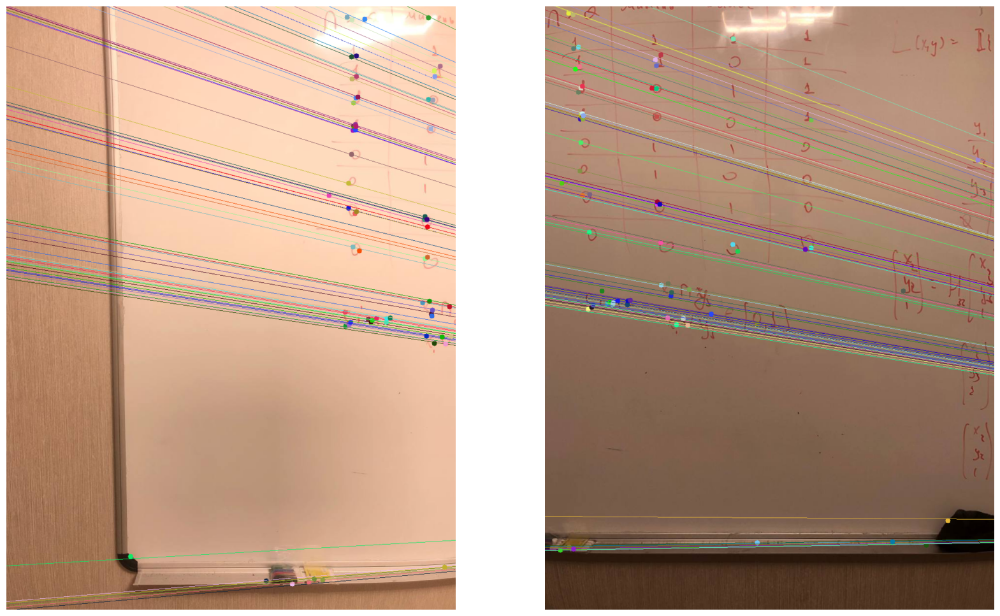

time: 682 ms (started: 2023-03-11 14:21:17 +03:00)


In [76]:
# _ = plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.imshow(img_vis_0)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(img_vis_1)
plt.axis("off")
plt.show()